# 2. MDETR - Modulated Detection for End-to-End Multi-Modal Understanding



Ссылка на статью https://arxiv.org/pdf/2104.12763.pdf

Ссылка на гит https://github.com/ashkamath/mdetr

Ссылка на демо колаб https://colab.research.google.com/github/ashkamath/mdetr/blob/colab/notebooks/MDETR_demo.ipynb



Архитектура 

![](https://i.ibb.co/cgnQsBp/image.png)

#### Установим библиотеки

In [ ]:
! pip install timm==0.4.5 transformers==4.5.1

#### Необходимые импорты

In [2]:
import torch
from PIL import Image
import requests
import torchvision.transforms as T
import matplotlib.pyplot as plt
from collections import defaultdict
import torch.nn.functional as F
import numpy as np
from skimage.measure import find_contours

from matplotlib import patches,  lines
from matplotlib.patches import Polygon

torch.set_grad_enabled(False);

 ### Utils

In [3]:
# standard PyTorch mean-std input image normalization
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

In [4]:
# colors for visualization
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

def apply_mask(image, mask, color, alpha=0.5):
    """Apply the given mask to the image.
    """
    for c in range(3):
        image[:, :, c] = np.where(mask == 1,
                                  image[:, :, c] *
                                  (1 - alpha) + alpha * color[c] * 255,
                                  image[:, :, c])
    return image

def plot_results(pil_img, scores, boxes, labels, masks=None):
    plt.figure(figsize=(16,10))
    np_image = np.array(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    if masks is None:
      masks = [None for _ in range(len(scores))]
    assert len(scores) == len(boxes) == len(labels) == len(masks)
    for s, (xmin, ymin, xmax, ymax), l, mask, c in zip(scores, boxes.tolist(), labels, masks, colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        text = f'{l}: {s:0.2f}'
        ax.text(xmin, ymin, text, fontsize=15, bbox=dict(facecolor='white', alpha=0.8))

        if mask is None:
          continue
        np_image = apply_mask(np_image, mask, c)

        padded_mask = np.zeros((mask.shape[0] + 2, mask.shape[1] + 2), dtype=np.uint8)
        padded_mask[1:-1, 1:-1] = mask
        contours = find_contours(padded_mask, 0.5)
        for verts in contours:
          # Subtract the padding and flip (y, x) to (x, y)
          verts = np.fliplr(verts) - 1
          p = Polygon(verts, facecolor="none", edgecolor=c)
          ax.add_patch(p)


    plt.imshow(np_image)
    plt.axis('off')
    plt.show()


def add_res(results, ax, color='green'):
    #for tt in results.values():
    if True:
        bboxes = results['boxes']
        labels = results['labels']
        scores = results['scores']
        #keep = scores >= 0.0
        #bboxes = bboxes[keep].tolist()
        #labels = labels[keep].tolist()
        #scores = scores[keep].tolist()
    #print(torchvision.ops.box_iou(tt['boxes'].cpu().detach(), torch.as_tensor([[xmin, ymin, xmax, ymax]])))
    
    colors = ['purple', 'yellow', 'red', 'green', 'orange', 'pink']
    
    for i, (b, ll, ss) in enumerate(zip(bboxes, labels, scores)):
        ax.add_patch(plt.Rectangle((b[0], b[1]), b[2] - b[0], b[3] - b[1], fill=False, color=colors[i], linewidth=3))
        cls_name = ll if isinstance(ll,str) else CLASSES[ll]
        text = f'{cls_name}: {ss:.2f}'
        print(text)
        ax.text(b[0], b[1], text, fontsize=15, bbox=dict(facecolor='white', alpha=0.8))

### Задача детекции

### Загрузим модель

In [5]:
model, postprocessor = torch.hub.load('ashkamath/mdetr:main', 'mdetr_efficientnetB5', pretrained=True, return_postprocessor=True)
model = model.cuda()
model.eval();

/usr/local/lib/python3.7/dist-packages/torch/hub.py:267: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  "You are about to download and run code from an untrusted repository. In a future release, this won't "
Downloading: "https://github.com/ashkamath/mdetr/zipball/main" to /root/.cache/torch/hub/main.zip
Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/tf_efficientnet_b5_ns-6f26d0cf.pth" to /root/.cache/torch/hub/checkpoints

Downloading:   0%|          | 0.00/899k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/481 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/501M [00:00<?, ?B/s]

Downloading: "https://zenodo.org/record/4721981/files/pretrained_EB5_checkpoint.pth" to /root/.cache/torch/hub/checkpoints/pretrained_EB5_checkpoint.pth


  0%|          | 0.00/2.53G [00:00<?, ?B/s]

In [6]:
url = "https://i.ibb.co/dKK9Z3V/6Z2-5709.jpg"
im = Image.open(requests.get(url, stream=True).raw)

In [7]:
def plot_inference(im, caption):
  # mean-std normalize the input image (batch-size: 1)
  img = transform(im).unsqueeze(0).cuda()


  # propagate through the model
  memory_cache = model(img, [caption], encode_and_save=True)
  
  outputs = model(img, [caption], encode_and_save=False, memory_cache=memory_cache)
  
  # keep only predictions with 0.7+ confidence
  probas = 1 - outputs['pred_logits'].softmax(-1)[0, :, -1].cpu()
  keep = (probas > 0.3).cpu()

  # convert boxes from [0; 1] to image scales
  bboxes_scaled = rescale_bboxes(outputs['pred_boxes'].cpu()[0, keep], im.size)

  # Extract the text spans predicted by each box
  positive_tokens = (outputs["pred_logits"].cpu()[0, keep].softmax(-1) > 0.1).nonzero().tolist()
  predicted_spans = defaultdict(str)
  for tok in positive_tokens:
    item, pos = tok
    if pos < 255:
        span = memory_cache["tokenized"].token_to_chars(0, pos)
        predicted_spans [item] += " " + caption[span.start:span.end]

  labels = [predicted_spans [k] for k in sorted(list(predicted_spans .keys()))]
  plot_results(im, probas[keep], bboxes_scaled, labels)

#### Эксперимент 1. Дмитрий Александрович

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


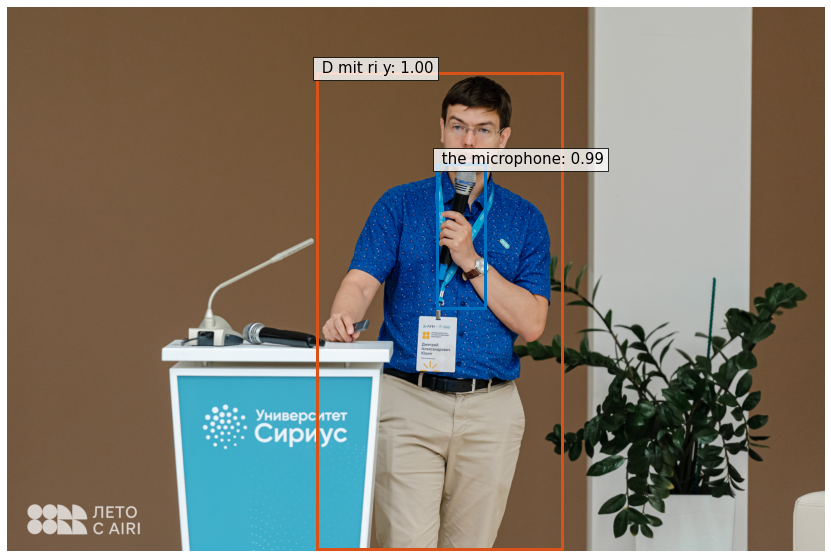

In [8]:
# Работает ли модель?
plot_inference(im, "Dmitriy holds the microphone")

One shot learning!

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


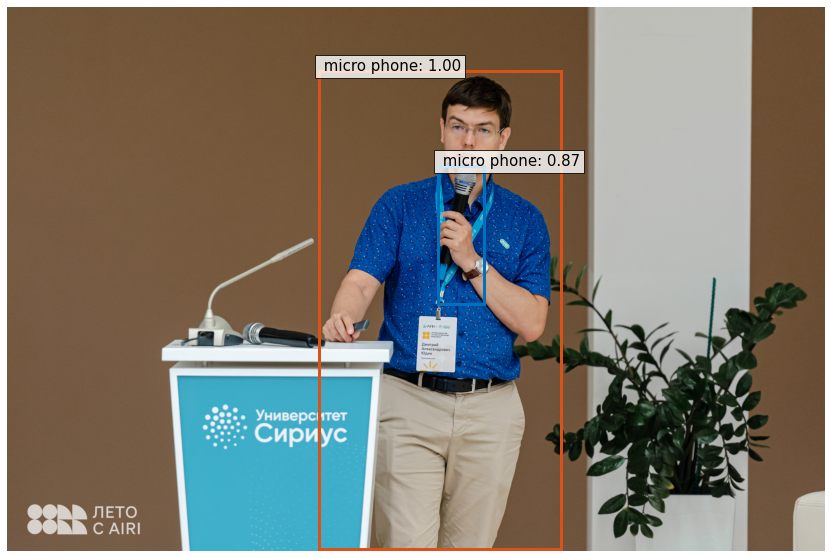

In [9]:
# Не все так просто. А теперь только микрофон!
plot_inference(im, "microphone")

Уже чуть хуже

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


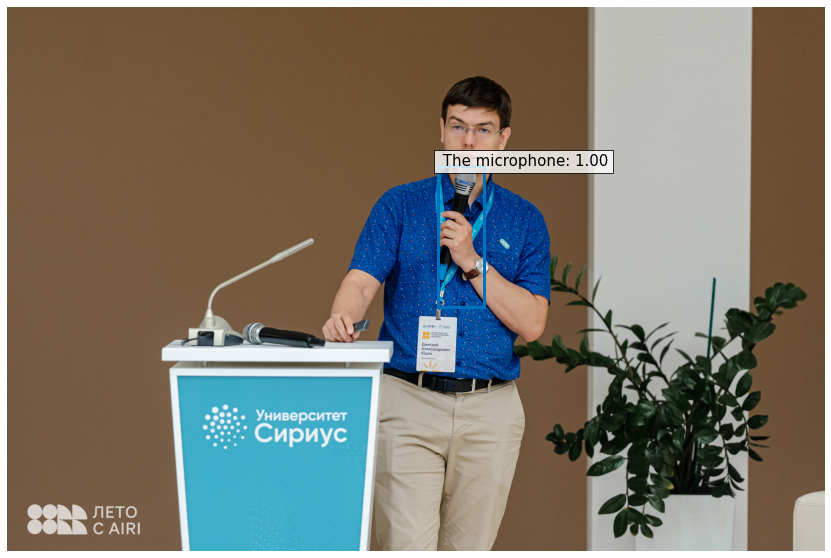

In [14]:
# Ладно, уточним
plot_inference(im, "The microphone")

Осталось еще два микрофона...

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


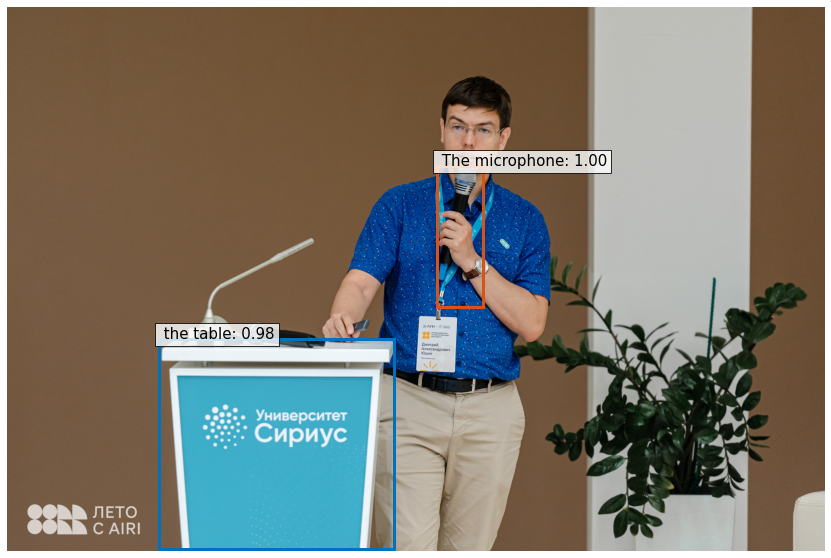

In [10]:
# Что-нибудь попроще...
plot_inference(im, "The microphone is on the table")

Спорно.

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


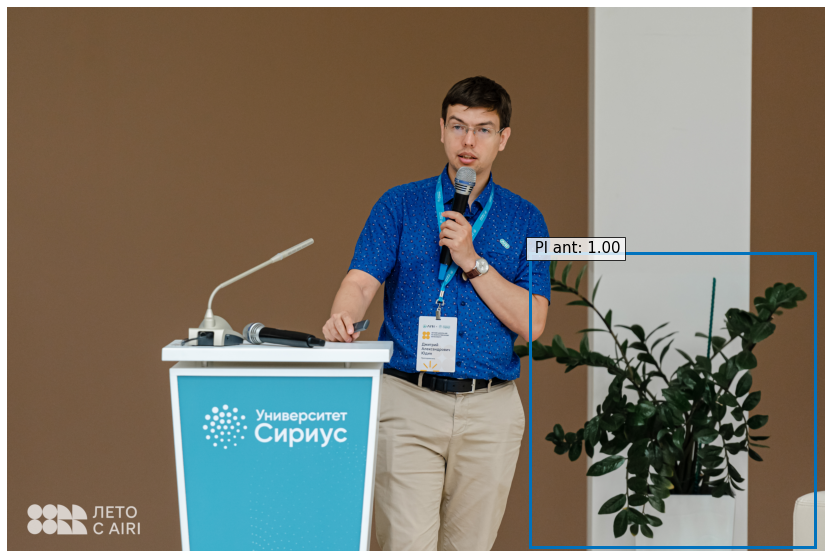

In [15]:
# Еще проще
plot_inference(im, "Plant")

Отлично!

### Ответы на вопросы по изображениям

Модель тренировалась на датасете GQA, поэтому хорошо научилась отвечать на схожие вопросы (но в наборе данных GQA нет вопросов на подсчет объектов)

GQA -> https://arxiv.org/pdf/1902.09506.pdf

Типы вопросов в наборе данных GQA
![](https://i.ibb.co/YbDVKw3/image.png)

На что это похоже?

- Compositional Language and Elementary Visual Reasoning (CLEVR, 2016, https://arxiv.org/pdf/1612.06890.pdf)

![](https://i.ibb.co/5kqLrW0/image.png)

In [ ]:
model_qa = torch.hub.load('ashkamath/mdetr:main', 'mdetr_efficientnetB5_gqa', pretrained=True, return_postprocessor=False)
model_qa = model_qa.cuda()
model_qa.eval()

Загрузим словарь содержащий пары (id, вопрос)

In [12]:
import json
answer2id_by_type = json.load(requests.get("https://nyu.box.com/shared/static/j4rnpo8ixn6v0iznno2pim6ffj3jyaj8.json", stream=True).raw)
id2answerbytype = {}                                                       
for ans_type in answer2id_by_type.keys():                        
    curr_reversed_dict = {v: k for k, v in answer2id_by_type[ans_type].items()}
    id2answerbytype[ans_type] = curr_reversed_dict                             

In [13]:
def plot_inference_qa(im, caption):
  
  # mean-std normalize the input image (batch-size: 1)
  img = transform(im).unsqueeze(0).cuda()

  # propagate through the model
  memory_cache = model_qa(img, [caption], encode_and_save=True)
  outputs = model_qa(img, [caption], encode_and_save=False, memory_cache=memory_cache)

  # keep only predictions with 0.7+ confidence
  probas = 1 - outputs['pred_logits'].softmax(-1)[0, :, -1].cpu()
  keep = (probas > 0.7).cpu()

  # convert boxes from [0; 1] to image scales
  bboxes_scaled = rescale_bboxes(outputs['pred_boxes'].cpu()[0, keep], im.size)

  # Extract the text spans predicted by each box
  positive_tokens = (outputs["pred_logits"].cpu()[0, keep].softmax(-1) > 0.1).nonzero().tolist()
  predicted_spans = defaultdict(str)
  for tok in positive_tokens:
    item, pos = tok
    if pos < 255:
        span = memory_cache["tokenized"].token_to_chars(0, pos)
        predicted_spans [item] += " " + caption[span.start:span.end]

  labels = [predicted_spans [k] for k in sorted(list(predicted_spans .keys()))]
  plot_results(im, probas[keep], bboxes_scaled, labels)

  # Classify the question type
  type_conf, type_pred = outputs["pred_answer_type"].softmax(-1).max(-1)
  ans_type = type_pred.item()
  types = ["obj", "attr", "rel", "global", "cat"]

  ans_conf, ans = outputs[f"pred_answer_{types[ans_type]}"][0].softmax(-1).max(-1)
  answer = id2answerbytype[f"answer_{types[ans_type]}"][ans.item()]
  print(f"Predicted answer: {answer}\t confidence={round(100 * type_conf.item() * ans_conf.item(), 2)}")

In [31]:
image_urls = [
    'https://upload.wikimedia.org/wikipedia/commons/3/38/Adorable-animal-cat-20787.jpg',
    'https://imgc.allpostersimages.com/img/print/posters/cat-black-jumping-off-wall_a-G-12469828-14258383.jpg',
    'https://i.ytimg.com/vi/AIwlyly7Eso/hqdefault.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/9/9b/Black_pussy_-_panoramio.jpg',
    'https://www.thehappycatsite.com/wp-content/uploads/2017/06/siamese5.jpg',
    'https://c.pxhere.com/photos/15/e5/cat_roof_home_architecture_building_roofs_animal_sit-536976.jpg!d',
    'https://upload.wikimedia.org/wikipedia/commons/thumb/a/a3/June_odd-eyed-cat.jpg/737px-June_odd-eyed-cat.jpg',
]


Для того, чтобы понять, на что обратила внимание модель, мы будем рисовать ограничительные рамки для объектов с высокой степенью уверенности.


Посмотрим, как работает модель и есть ли языковая предвзятость.

#### Эксперимент 1. Черная кошка. 
Свойства объектов

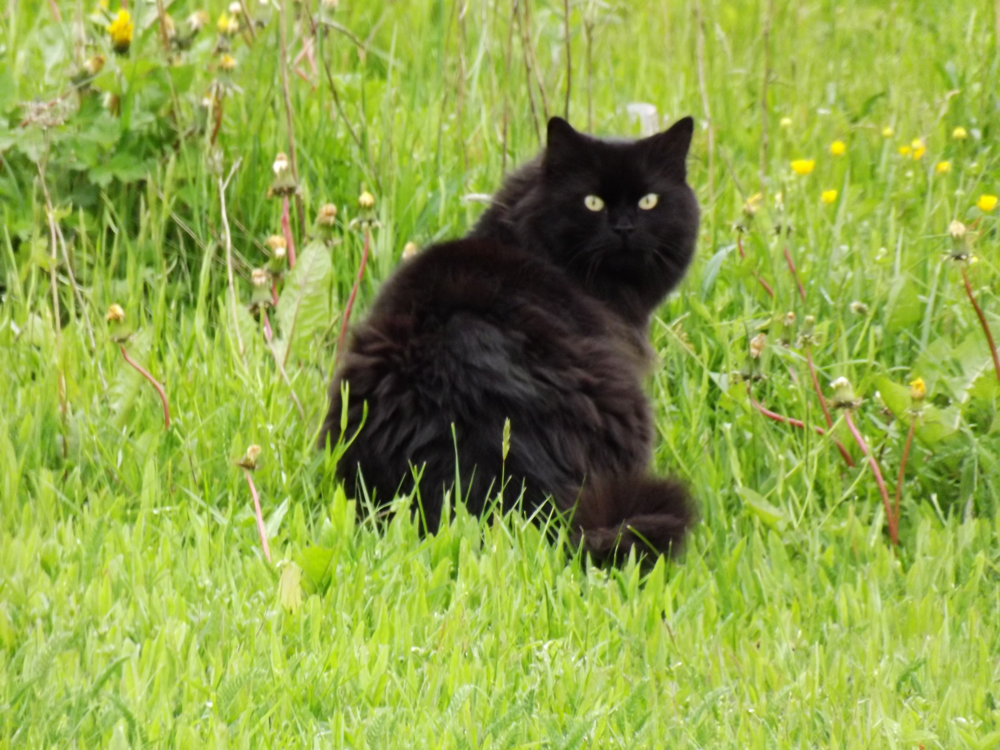

In [38]:
# Возьмем одну из прошлых картинок
black_cat_url = 'https://i.ibb.co/mTHr0pX/Black-pussy-panoramio.jpg'
black_cat = Image.open(requests.get(black_cat_url, stream=True).raw)
black_cat

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


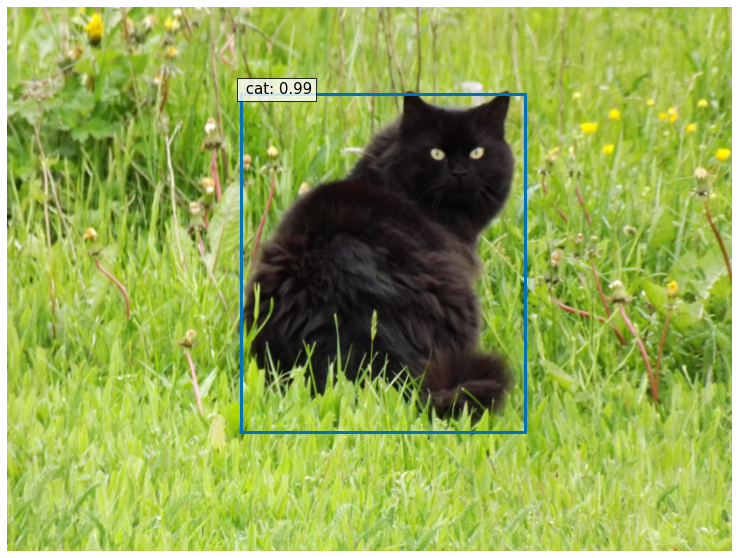

Predicted answer: black	 confidence=96.97


In [39]:
plot_inference_qa(black_cat, "What color is the cat?")

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


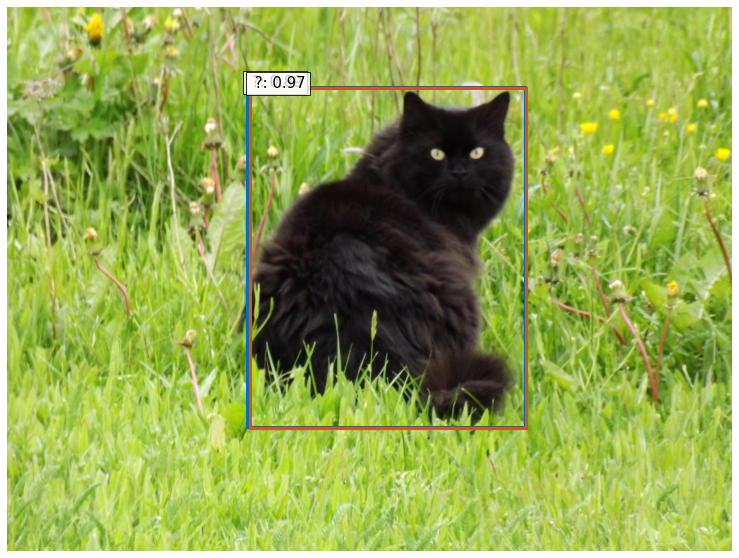

Predicted answer: bear	 confidence=91.68


In [48]:
plot_inference_qa(black_cat, "cat?")

Language bias

![](https://i.ibb.co/HGKqZGp/istockphoto-1255448370-612x612.jpg)

#### Эксперимент 2. Прыгающая кошка

In [ ]:
jumping_cat = Image.open(requests.get(image_urls[1], stream=True).raw)
jumping_cat

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


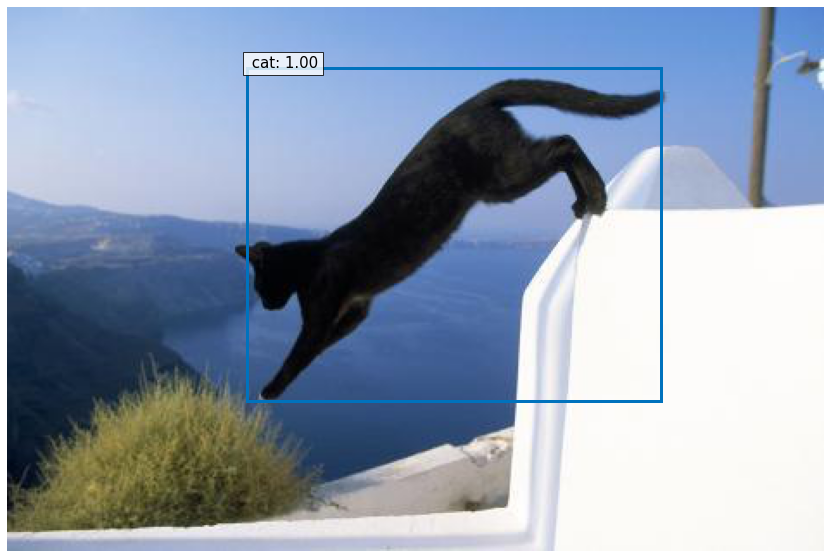

Predicted answer: black	 confidence=97.76


In [ ]:
# Начнем с чего нибудь попроще! Какого цвета кошка?
plot_inference_qa(jumping_cat, "What color is the cat?")

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


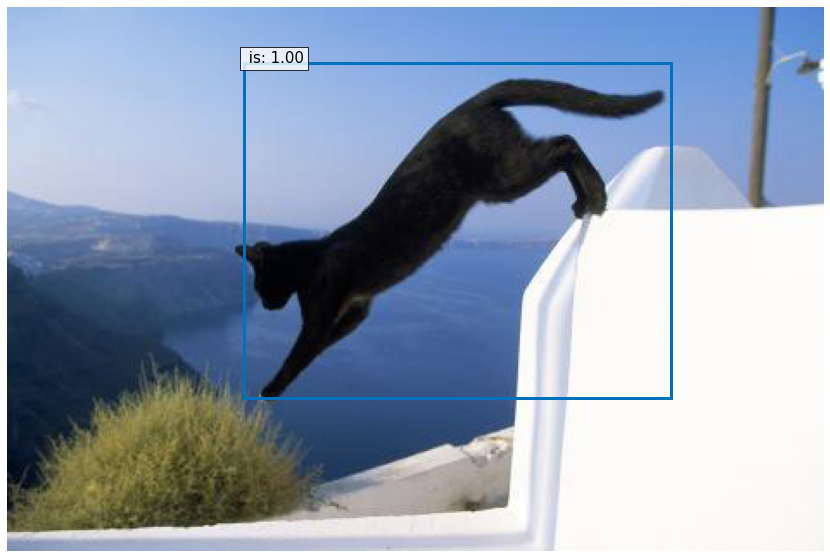

Predicted answer: up	 confidence=85.47


In [ ]:
plot_inference_qa(jumping_cat, "Cat is jumping up or down?")

#### Эксперимент 3. Небо

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


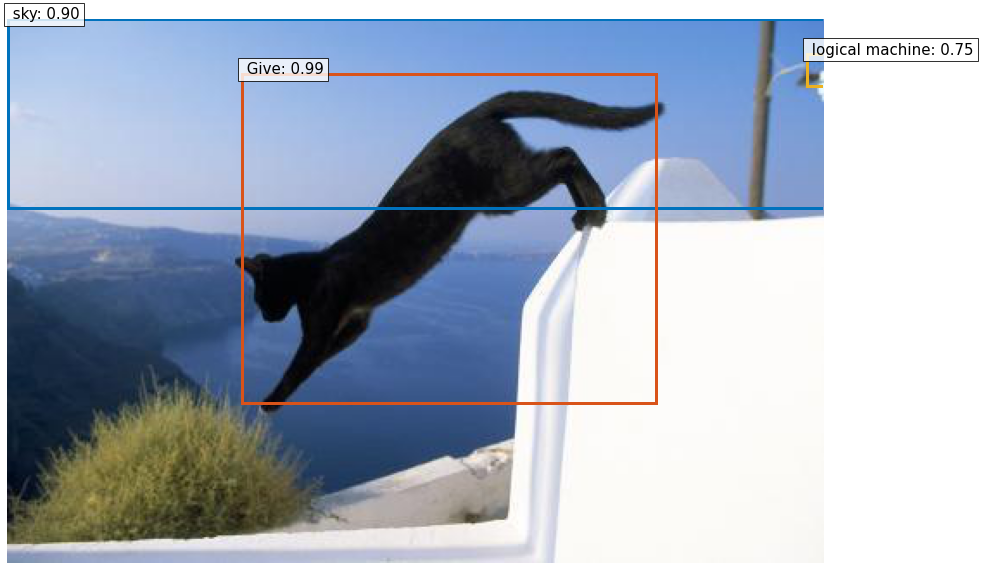

Predicted answer: yes	 confidence=89.94


In [ ]:
plot_inference_qa(im2, "Give the answer that the logical machine gave to the question What is the sky?")

##### Больше неба!

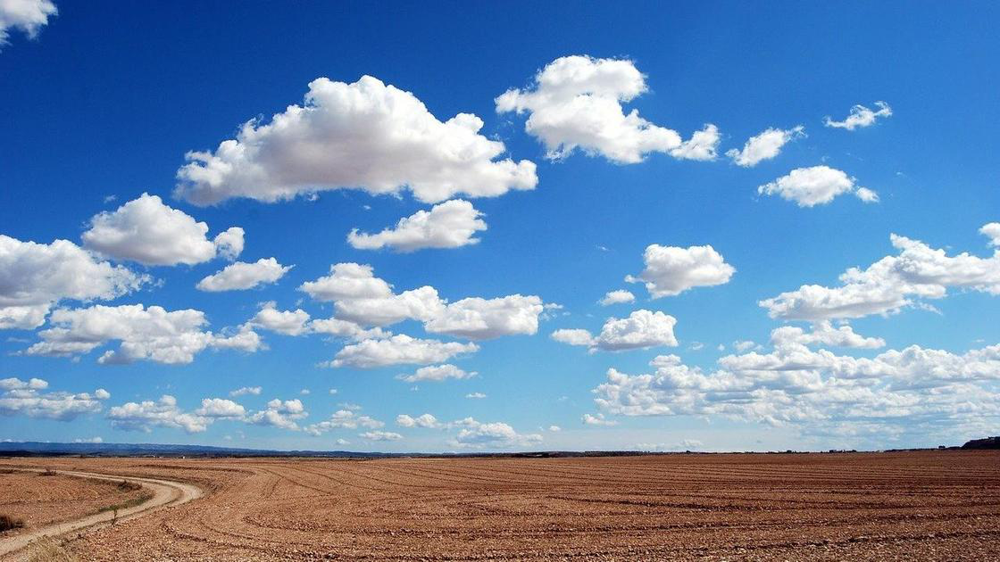

In [ ]:
sky_url = "https://cdn.nur.kz/images/1120x630/79f590e8362a7655.jpeg"
sky_img = Image.open(requests.get(sky_url, stream=True).raw)
sky_img

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


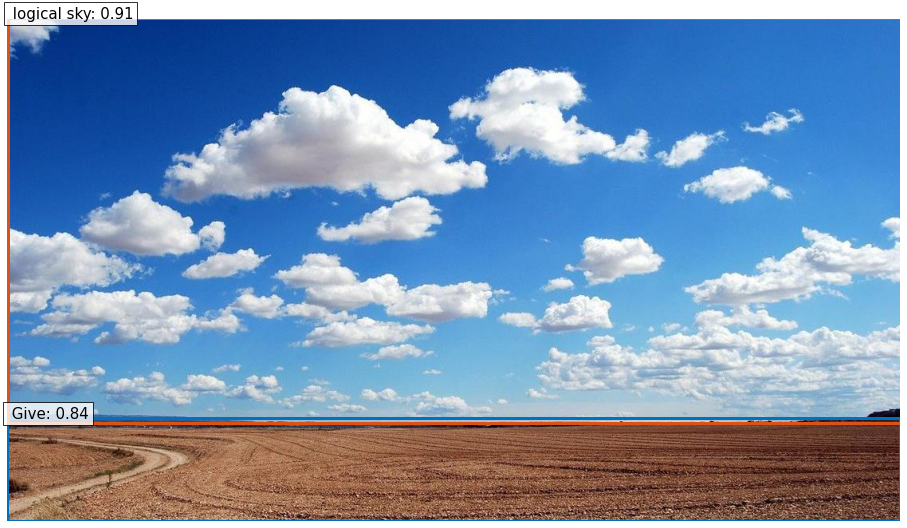

Predicted answer: sky	 confidence=51.77


#### Эксперимент 4. Банан

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


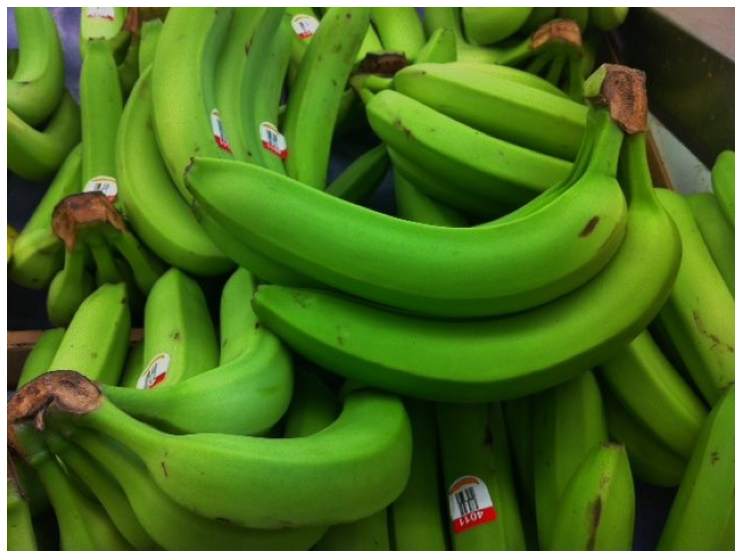

Predicted answer: green	 confidence=98.21


In [29]:
banana_url = "https://i.ibb.co/RjwbFk4/photo-2.jpg"
banana_img = Image.open(requests.get(banana_url, stream=True).raw)
plot_inference_qa(banana_img, "What color is the banana?")

Эксперимент 5. Visual Commonsense Reasoning

https://arxiv.org/pdf/1811.10830.pdf

![](https://i.ibb.co/Sy4j2Md/VCR-0000000216-581da9d9-cc-Hlrxk.jpg)

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


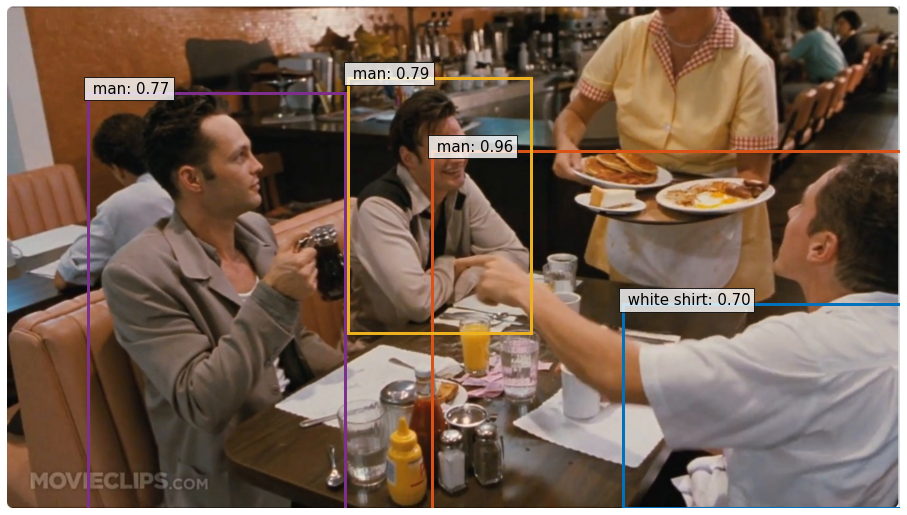

Predicted answer: menu	 confidence=13.57


In [41]:
person_url = 'https://i.ibb.co/9Yyp8Hm/e-B6-S3o3zg-I-G51q-Gd5-YZh-LVa-Tqdj-Ji-GCgjk-Ji9vo-K0-Ci-Z3-DX1-Lw-TNk-VJ8qd-WYsg-Hcv-RBUHD-LJZn-F61.jpg'
person_img = Image.open(requests.get(person_url, stream=True).raw)
plot_inference_qa(person_img, "Why is the man in the white shirt pointing at the other")

/root/.cache/torch/hub/ashkamath_mdetr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


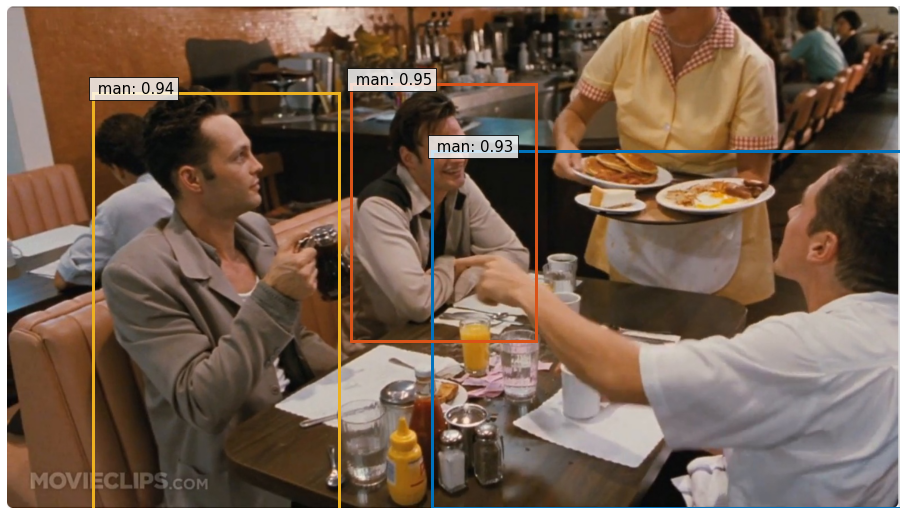

Predicted answer: glass	 confidence=38.95


In [55]:
plot_inference_qa(person_img, "Why is the man pointing at the another")

#### Спасибо за внимание!